In [30]:
import numpy as np
import pandas as pd
import plotly as plt
import plotly.express as px
import plotly.figure_factory as ff
import scipy.stats
import tensorflow as tf
import tensorflow_probability as tfp
import umap as umap

tfkl = tf.keras.layers
tfk = tf.keras
tfd = tfp.distributions
tfb = tfp.bijectors
tfko = tf.keras.optimizers
tfpl = tfp.layers

# Ripe rimu in 2002 and 2019 on Whenua Hou, 2016 and 2019 on Anchor

# TODO:! Sex ratio of offspring!

In [31]:
fertility = pd.read_csv("fertility_confirmed_father.csv")
fertility.columns

Index(['bird', 'Island', 'Clutch', 'year', 'Father', 'fertile eggs',
       'infertile eggs', 'dead embryo', 'egg loss', 'hatched', 'chick death',
       'Fledged', 'clutch size', 'clutch fertility', 'number of matings',
       'number of AI', '1st egg fertile X days from father's last mating',
       '2nd egg fertile X days from father's last mating',
       '3rd egg fertile X days from father's last mating',
       '4th egg fertile X days from father's last mating',
       '5th egg fertile X days from father's last mating',
       '1st egg Infertile days from last mating',
       '2nd egg Infertile days from last mating',
       '3rd egg Infertile days from last mating',
       '4th egg Infertile days from last mating',
       '5th egg Infertile days from last mating',
       '1st egg laid days since last mating',
       'Very early dead embryo <5 days (microscopic)',
       'Very early dead embryo not determined', 'early dead embryo 5-10d',
       'mid DE 11-20d', 'Late DE 21-30d', 

In [32]:
weights = pd.read_csv("all_weights_by_year_mean.tsv", sep="\t")
weights["year"] = [x[0:4] for x in weights["year"].astype(str)]
# weights

In [33]:
# weights[(weights["birdName"] == "Suzanne") & (weights["year"] == "2016")]

for i, x in fertility.iterrows():
    bird = x["bird"]
    year = x["year"]
    # print(bird)
    # print(year)

    weight = weights[
        (weights["birdName"] == bird) & (weights["year"] == str(year))
    ].values.tolist()[0][2]
    age = weights[
        (weights["birdName"] == bird) & (weights["year"] == str(year))
    ].values.tolist()[0][4]

    fertility.loc[i, "year_weight"] = weight
    fertility.loc[i, "year_age"] = age

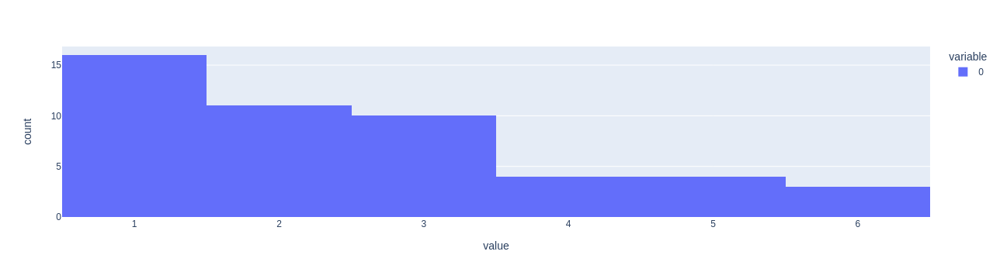

In [34]:
px.histogram(fertility.groupby("bird").agg("size"))

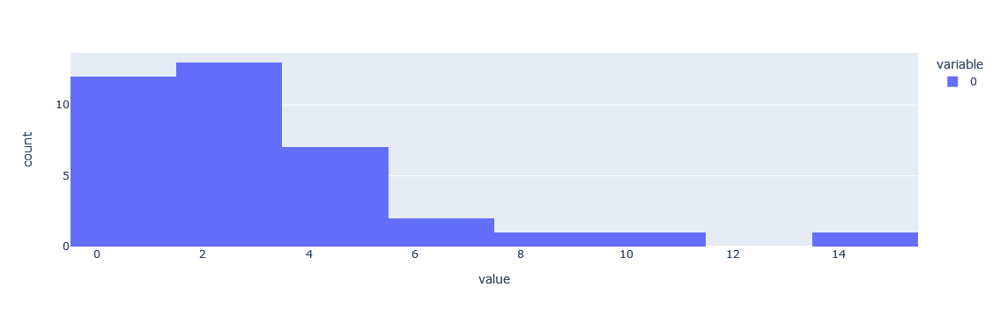

In [35]:
px.histogram(fertility.groupby("Father").agg("size"))

In [36]:
fertility.columns

Index(['bird', 'Island', 'Clutch', 'year', 'Father', 'fertile eggs',
       'infertile eggs', 'dead embryo', 'egg loss', 'hatched', 'chick death',
       'Fledged', 'clutch size', 'clutch fertility', 'number of matings',
       'number of AI', '1st egg fertile X days from father's last mating',
       '2nd egg fertile X days from father's last mating',
       '3rd egg fertile X days from father's last mating',
       '4th egg fertile X days from father's last mating',
       '5th egg fertile X days from father's last mating',
       '1st egg Infertile days from last mating',
       '2nd egg Infertile days from last mating',
       '3rd egg Infertile days from last mating',
       '4th egg Infertile days from last mating',
       '5th egg Infertile days from last mating',
       '1st egg laid days since last mating',
       'Very early dead embryo <5 days (microscopic)',
       'Very early dead embryo not determined', 'early dead embryo 5-10d',
       'mid DE 11-20d', 'Late DE 21-30d', 

In [37]:
x = fertility[
    [
        "bird",
        "Father",
        "year",
        "Island",
        "clutch size",
        "infertile eggs",
        "fertile eggs",
        "dead embryo",
        "Very early dead embryo <5 days (microscopic)",
        "Very early dead embryo not determined",
        "early dead embryo 5-10d",
        "mid DE 11-20d",
        "Late DE 21-30d",
        # "year_weight",
        # "year_age",
    ]
].copy()
# x["ratio"] = 1 - (x["Very early dead embryo <5 days (microscopic)"]/x["clutch size"])
x["ratio"] = 1 - (x["dead embryo"] / x["fertile eggs"])
x['ratiob'] = 1 - (x['dead embryo'] / x['clutch size'])
# x['ratio'] = 1 - (x['Very early dead embryo <5 days (microscopic)'] / x['clutch size'])
# x["ratio"] = 1 - (x["infertile eggs"] / x["clutch size"])
# x['ratio'] = x['clutch size']

x

,bird,Father,year,Island,clutch size,infertile eggs,fertile eggs,dead embryo,Very early dead embryo <5 days (microscopic),Very early dead embryo not determined,early dead embryo 5-10d,mid DE 11-20d,Late DE 21-30d,ratio,ratiob
0,Suzanne,Arab,2016,Whenua Hou,3,0,3,0,0.0,NaN,0.0,0.0,0.0,1.000000,1.000000
1,Kuihi,Barnard,2009,Whenua Hou,3,0,3,0,0.0,NaN,0.0,0.0,0.0,1.000000,1.000000
2,Flossie,Barnard,2011,Whenua Hou,2,0,2,0,0.0,NaN,0.0,0.0,0.0,1.000000,1.000000
3,Rakiura,Barnard,2011,Whenua Hou,3,0,3,0,0.0,NaN,0.0,0.0,0.0,1.000000,1.000000
4,Ruth,Basil,2002,Whenua Hou,3,0,3,1,0.0,NaN,1.0,NaN,NaN,0.666667,0.666667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117,Solstice,Waynebo,2011,Whenua Hou,3,0,3,0,0.0,NaN,0.0,0.0,0.0,1.000000,1.000000
118,Esperance,Whiskas,2009,Whenua Hou,3,0,3,2,0.0,NaN,2.0,0.0,0.0,0.333333,0.333333
119,Flossie,Whiskas,2009,Whenua Hou,3,0,3,0,0.0,NaN,0.0,0.0,0.0,1.000000,1.000000
120,Rakiura,Whiskas,2009,Whenua Hou,4,0,4,1,0.0,NaN,1.0,0.0,0.0,0.750000,0.750000


In [38]:
x[x["ratio"] < 1]

,bird,Father,year,Island,clutch size,infertile eggs,fertile eggs,dead embryo,Very early dead embryo <5 days (microscopic),Very early dead embryo not determined,early dead embryo 5-10d,mid DE 11-20d,Late DE 21-30d,ratio,ratiob
4,Ruth,Basil,2002,Whenua Hou,3,0,3,1,0.0,NaN,1.0,NaN,NaN,0.666667,0.666667
6,Sue,Basil,2002,Whenua Hou,3,0,3,1,0.0,NaN,1.0,NaN,NaN,0.666667,0.666667
11,Aparima,Basil,2019,Anchor,3,0,3,1,0.0,NaN,1.0,0.0,0.0,0.666667,0.666667
12,Yasmine,Basil,2019,Anchor,4,0,4,4,0.0,NaN,4.0,0.0,0.0,0.000000,0.000000
14,Wendy,Bill,1991,Hauturu,3,0,3,1,0.0,NaN,1.0,NaN,NaN,0.666667,0.666667
15,Cyndy,Bill,2002,Whenua Hou,3,0,3,2,0.0,NaN,1.0,NaN,1.0,0.333333,0.333333
17,Flossie,Bill,2005,Whenua Hou,3,0,3,1,0.0,NaN,NaN,NaN,1.0,0.666667,0.666667
20,Aranga,Blades,2009,Whenua Hou,3,0,3,1,0.0,NaN,0.0,1.0,0.0,0.666667,0.666667
23,Aranga,Blades,2011,Whenua Hou,2,0,2,1,0.0,NaN,1.0,0.0,0.0,0.500000,0.500000
24,Lisa,Blades,2011,Whenua Hou,3,0,3,2,0.0,NaN,2.0,0.0,0.0,0.333333,0.333333


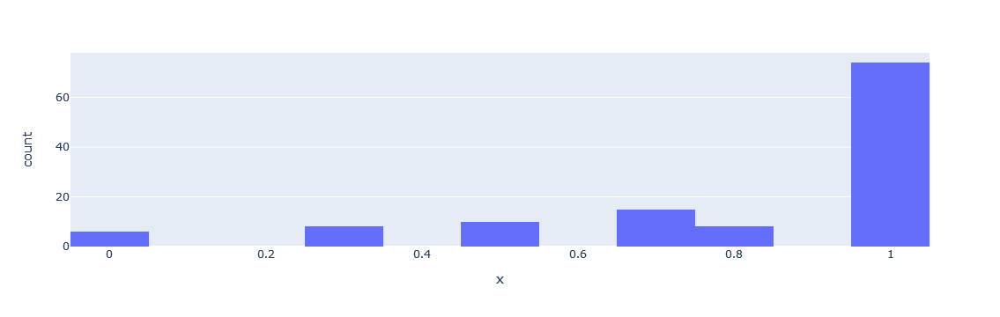

In [39]:
px.histogram(x=x["ratio"])
# px.histogram(x=x["ratio"])

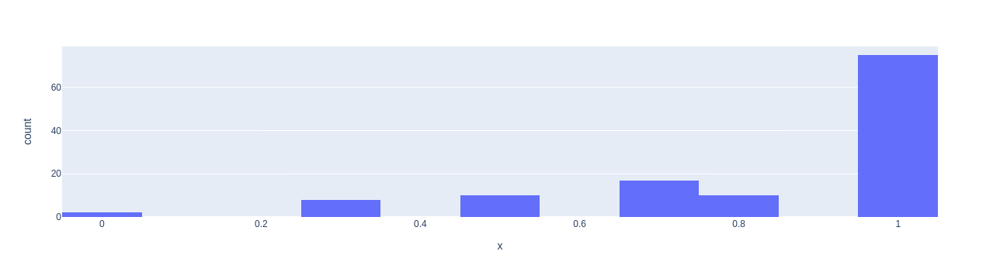

In [40]:
px.histogram(x=x['ratiob'])

In [41]:
fertility_heatmap_df = (
    x[["bird", "Father", "ratio"]]
    .groupby(by=["bird", "Father"])
    .aggregate("mean")
    .reset_index()
)

In [42]:
fertility_heatmap_df

,bird,Father,ratio
0,Alice,Boss,0.750000
1,Alice,Felix,1.000000
2,Alice,Gumboots,1.000000
3,Alice,Smoko,0.000000
4,Alice,Waynebo,0.666667
...,...,...,...
98,Wendy,Boss,1.000000
99,Wendy,Manu,0.000000
100,Wendy,Waynebo,0.750000
101,Yasmine,Basil,0.000000


In [43]:
birds = fertility_heatmap_df["bird"].unique()
fathers = fertility_heatmap_df["Father"].unique()
# birds
# fathers

In [44]:
fertility_heatmap = np.ones((len(birds), len(fathers)))
fertility_heatmap.fill(-1)

m = 0
n = 0
for mom in birds:
    n = 0
    momdf = fertility_heatmap_df[fertility_heatmap_df["bird"] == mom]
    for father in fathers:
        data = momdf[momdf["Father"] == father]["ratio"]
        if len(data) == 1:
            fertility_heatmap[m][n] = data.values[0]
        n += 1
    m += 1

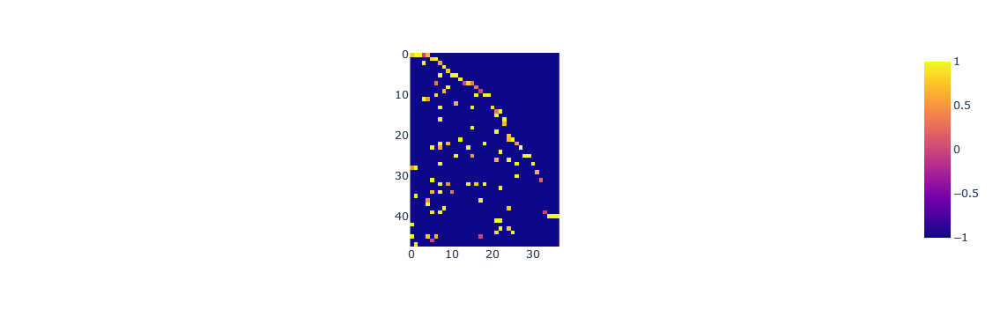

In [45]:
px.imshow(fertility_heatmap)

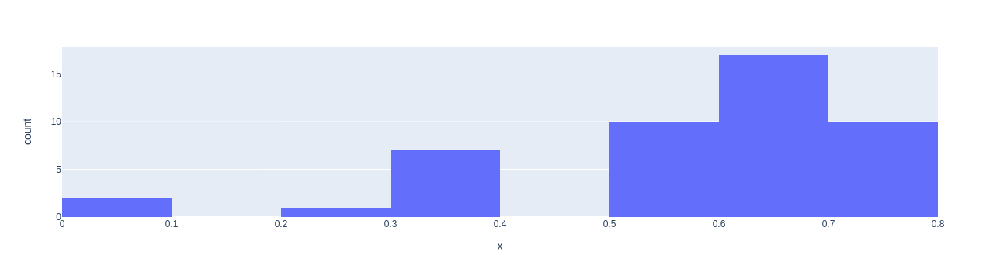

In [46]:
fertility_ratios = x[x["ratiob"] < 1]["ratiob"].to_list()
px.histogram(x=fertility_ratios)

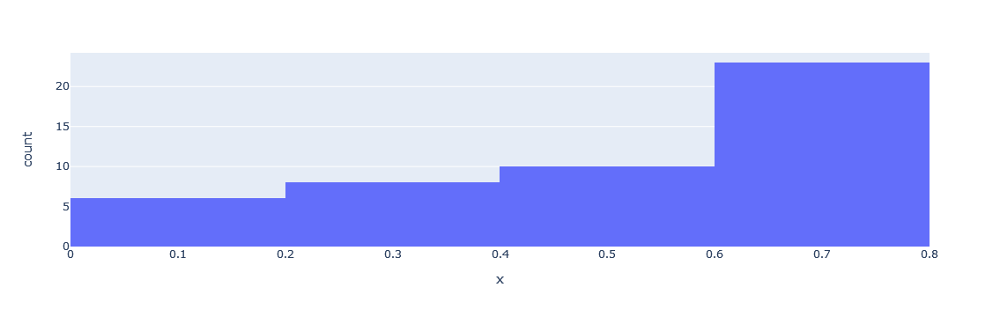

In [47]:
fertility_ratios = x[x["ratio"] < 1]["ratio"].to_list()
px.histogram(x=fertility_ratios)

In [48]:
len(fertility_ratios)

47

gm = tfd.MixtureSameFamily(
    mixture_distribution=tfd.Categorical(
        probs=[0.1, 0.9]),
    components_distribution=tfd.Normal(
      loc=[0.25, 0.75],       # One for each component.
      scale=[0.2, 0.2]))  # And same here.

gm = tfd.TransformedDistribution(gm, tfb.Sigmoid())

x = np.linspace(0., 1., int(1e4), dtype=np.float32)
import matplotlib.pyplot as plt
plt.plot(x, gm.prob(x).numpy());


px.histogram(gm.sample(30))

In [49]:
x['year'].max()

2021

In [50]:
np.mean(x['ratio'])

0.806473829201102

In [51]:
x.dropna(subset=["ratio"], inplace=True)
x['ratio']

0      1.000000
1      1.000000
2      1.000000
3      1.000000
4      0.666667
         ...   
116    0.500000
117    1.000000
118    0.333333
119    1.000000
120    0.750000
Name: ratio, Length: 121, dtype: float64

## Model

In [52]:
def make_categorical(df, column):
    df[column] = df[column].astype("category")
    df[column + "_code"] = df[column].cat.codes
    df[column + "_code"] = df[column + "_code"].astype("int32")
    return df


labels = x[["ratio"]].astype(np.float32).values.flatten()


def target_log_prob_fn(*args):
    return formula.log_prob(*args, output=labels)


Root = tfd.JointDistributionCoroutine.Root  # Convenient alias.

fertility = make_categorical(x, "Island")
fertility = make_categorical(x, "bird")
fertility = make_categorical(x, "year")
fertility = make_categorical(x, "Father")

n_islands = x["Island"].nunique()
n_years = x["year"].nunique()
n_birds = x["bird"].nunique()
n_fathers = x["Father"].nunique()


def make_formula(
    birds, fathers, n_birds, n_fathers
):
    def model():
        bird_prior = yield Root(
            tfd.Logistic(loc=tf.ones(n_birds), scale=tf.ones(n_birds), name="mother")
        )
        
        father_prior = yield Root(
            tfd.Logistic(loc=tf.ones(n_fathers), scale=tf.ones(n_fathers), name="father")
        )

        bird_scale_prior = yield Root(
            tfd.Normal(
                loc=tf.ones(n_birds), scale=tf.ones(n_birds), name="mother_scale"
            )
        )
        
        father_scale_prior = yield Root(
            tfd.Normal(
                loc=tf.ones(n_fathers), scale=tf.ones(n_fathers), name="father_scale"
            )
        )

        intercept = yield Root(
            tfd.Normal(loc=np.mean(labels), scale=0.05, name="intercept")
        )

        bird_effect = tf.gather(bird_prior, birds, axis=-1)
        father_effect = tf.gather(father_prior, fathers, axis=-1)

        bird_scale = tf.gather(bird_scale_prior, birds, axis=-1)
        father_scale = tf.gather(father_scale_prior, fathers, axis=-1)

        y = (
            intercept
            + bird_effect
            * father_effect
        )

        scale = tf.math.sigmoid(tf.math.minimum(bird_scale, father_scale))

        yield tfd.Normal(
            y, scale=scale, allow_nan_stats=False, name="output", validate_args=True
        )

    return model, tfd.JointDistributionCoroutineAutoBatched(model)


model, formula = make_formula(
    x["bird_code"],
    x["Father_code"],
    n_birds,
    n_fathers,
)

formula.sample_distributions()[0]

StructTuple(
  mother=<tfp.distributions.Logistic 'JointDistributionCoroutineAutoBatched_sample_distributions_mother' batch_shape=[48] event_shape=[] dtype=float32>,
  father=<tfp.distributions.Logistic 'JointDistributionCoroutineAutoBatched_sample_distributions_father' batch_shape=[36] event_shape=[] dtype=float32>,
  mother_scale=<tfp.distributions.Normal 'JointDistributionCoroutineAutoBatched_sample_distributions_mother_scale' batch_shape=[48] event_shape=[] dtype=float32>,
  father_scale=<tfp.distributions.Normal 'JointDistributionCoroutineAutoBatched_sample_distributions_father_scale' batch_shape=[36] event_shape=[] dtype=float32>,
  intercept=<tfp.distributions.Normal 'JointDistributionCoroutineAutoBatched_sample_distributions_intercept' batch_shape=[] event_shape=[] dtype=float32>,
  output=<tfp.distributions.Normal 'JointDistributionCoroutineAutoBatched_sample_distributions_output' batch_shape=[121] event_shape=[] dtype=float32>
)

In [53]:
surrogate.sample()

[<tf.Tensor: shape=(48,), dtype=float32, numpy=
 array([ 0.07889023,  2.0992045 ,  0.35957223,  0.00589424, -0.44187343,
         1.5606225 ,  1.2449639 , -0.372039  , -0.8622894 ,  0.7947818 ,
        -0.06163536,  0.70616055, -0.10990667, -0.06479982,  0.40940326,
         1.2078317 , -0.03590941, -0.43762213, -0.06344774, -0.05810565,
         2.5452633 ,  1.4897077 ,  0.46855897, -0.3038185 ,  0.68571216,
        -0.21092051,  0.47497982,  0.00559163, -0.9098125 , -0.22487023,
        -1.2312055 ,  0.8450138 ,  0.9924756 ,  1.3253921 ,  1.3744414 ,
         1.8406849 ,  1.0633128 , -0.2173791 ,  0.3218086 , -0.5954128 ,
        -0.05383127,  1.5387135 , -1.1559551 , -2.2259579 ,  0.78277874,
        -0.14190382,  2.532977  ,  1.9764501 ], dtype=float32)>,
 <tf.Tensor: shape=(36,), dtype=float32, numpy=
 array([ 1.3887980e+00,  8.8186884e-01, -3.4390535e-02, -1.1991488e-01,
         1.8625315e-01, -2.8173879e-02,  6.0544472e-02, -7.7946568e-01,
         1.9615199e-01,  6.5827292e-01

In [55]:
_init_loc = lambda shape=(): tf.Variable(
    tf.random.uniform(shape, minval=-.01, maxval=.01)
)
_init_scale = lambda shape=(): tfp.util.TransformedVariable(
    initial_value=tf.random.uniform(shape, minval=0.5, maxval=1),
    bijector=tfb.Softplus(),
)

def gen_posterior():
    surrogate_part = [
        tfd.Normal(_init_loc([n_birds]), _init_scale([n_birds])),  # bird / mother
        tfd.Normal(_init_loc([n_fathers]), _init_scale([n_fathers])),  # father
        tfb.Softplus()(
            tfd.Normal(_init_loc([n_birds]), _init_scale([n_birds]))
        ),  # mother scale
        tfb.Softplus()(
            tfd.Normal(_init_loc([n_fathers]), _init_scale([n_fathers]))
        ),  # father scale
        tfd.Normal(np.mean(labels), _init_scale()),  # Intercept
    ]
    return surrogate_part


surrogate = tfd.JointDistributionSequentialAutoBatched(gen_posterior())

In [56]:
# csd = tfk.experimental.CosineDecayRestarts(1e-2, 4096)

losses = tfp.vi.fit_surrogate_posterior(
    target_log_prob_fn,
    surrogate,
    sample_size=122,
    optimizer=tf.optimizers.Adam(learning_rate=1e-4),
    num_steps=8192*24,
)

# csd = tfk.experimental.CosineDecayRestarts(1e-2, 4096)

#losses1 = tfp.vi.fit_surrogate_posterior(
#    target_log_prob_fn,
#    surrogate,
#    sample_size=2048,
#    optimizer=tf.optimizers.Adam(learning_rate=1e-3),
#    num_steps=2048,
#)

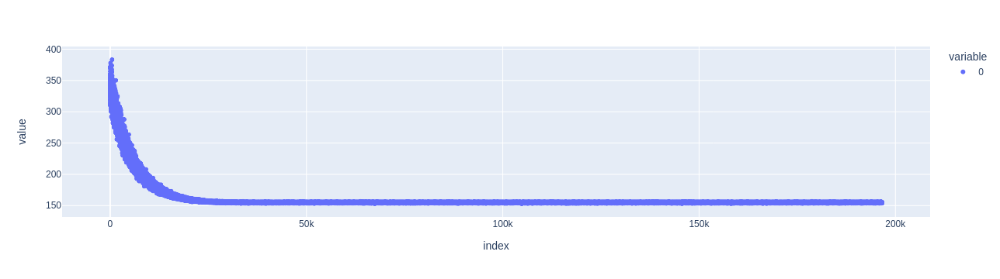

In [57]:
px.scatter(losses)

In [58]:
losses = tfp.vi.fit_surrogate_posterior(
    target_log_prob_fn,
    surrogate,
    sample_size=122,
    optimizer=tf.optimizers.Adam(learning_rate=1e-4),
    num_steps=8192*8,
)

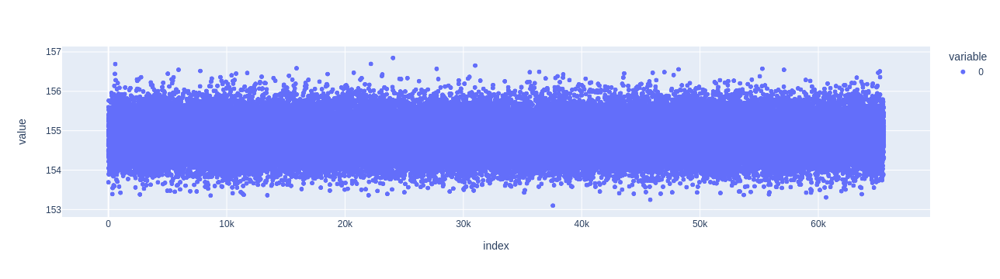

In [59]:
px.scatter(losses)

In [60]:
losses = tfp.vi.fit_surrogate_posterior(
    target_log_prob_fn,
    surrogate,
    sample_size=122,
    optimizer=tf.optimizers.Adam(learning_rate=1e-6),
    num_steps=8192*8,
)

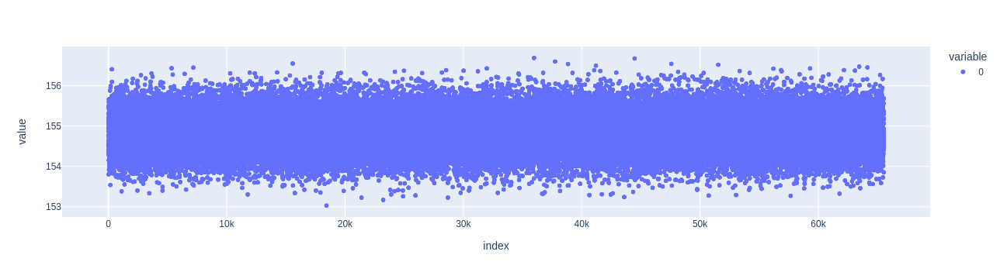

In [61]:
px.scatter(losses)

In [64]:
np.mean(losses[-1000:])

154.86926

# Save Weights

In [66]:
np.save("surviving_embryos_surrogate_model.npy", surrogate.model)
np.save("surviving_embryos_surrogate_parameters.npy", surrogate.parameters)
loaded = tfd.JointDistributionSequentialAutoBatched(
    model=list(np.load("surviving_embryos_surrogate_model.npy", allow_pickle=True)),
    #reparameterization_type=tfd.FULLY_REPARAMETERIZED)
    #parameters=np.load("surviving_embryos_surrogate_parameters.npy", allow_pickle=True))
)

[formula.log_prob(*loaded.sample(), output=labels), formula.log_prob(*surrogate.sample(), output=labels)]

[<tf.Tensor: shape=(), dtype=float32, numpy=-334.89017>,
 <tf.Tensor: shape=(), dtype=float32, numpy=-328.75226>]

In [67]:
(
    #year_scale_,
    #island_scale_,
    #island_,
    #year_,
    mother_,
    father_,
    mother_scale_,
    father_scale_,
    intercept_,
), _ = surrogate.sample_distributions()

In [68]:
father_scale_.sample()

<tf.Tensor: shape=(36,), dtype=float32, numpy=
array([0.4818465 , 0.3056025 , 0.18223955, 0.12757698, 0.4020552 ,
       0.02515703, 0.09918813, 0.62608486, 0.42862073, 0.6033648 ,
       1.3256785 , 1.3165647 , 1.9725169 , 2.528893  , 0.37335664,
       0.6945365 , 1.4327248 , 0.9297424 , 1.87957   , 0.35170275,
       1.2000575 , 0.899962  , 1.160642  , 0.8243527 , 1.1047448 ,
       1.4223883 , 1.1638814 , 0.4056072 , 0.37094697, 1.274186  ,
       0.66406137, 0.8245974 , 2.2221398 , 1.1175585 , 3.4890122 ,
       2.4364007 ], dtype=float32)>

In [69]:
intercept_.mean()

<tf.Tensor: shape=(), dtype=float32, numpy=0.8064738>

In [70]:
mother_.mean()

<tf.Tensor: shape=(48,), dtype=float32, numpy=
array([ 0.1330444 ,  0.4201817 ,  0.45792314,  0.73796964,  0.58529556,
        0.34587952,  0.5446854 , -0.22339381,  0.29091084,  0.84372556,
        0.12708113,  0.5235562 ,  0.46424618,  0.12157597,  0.7386349 ,
        0.8702376 ,  0.504488  ,  0.5195338 ,  0.48187628,  0.87228686,
        0.7858345 ,  0.37263545,  0.2167898 ,  0.27849084,  0.88403785,
        0.0816057 ,  0.6969697 ,  0.21510491,  0.59259814,  0.1406688 ,
        0.5538776 , -0.00550566,  0.19614647,  0.88133734,  0.36334673,
        0.8926503 ,  0.32325217,  0.7211899 ,  0.6278173 , -0.2577515 ,
        0.08151879,  0.7978124 ,  0.7107826 ,  0.7313595 ,  0.46153453,
        0.5407151 ,  1.1431056 ,  0.57787377], dtype=float32)>

In [71]:
father_.mean()

<tf.Tensor: shape=(36,), dtype=float32, numpy=
array([ 0.7962468 ,  0.23378362, -0.09309878,  0.10735991,  0.01826628,
        0.0134583 ,  0.04207043,  0.29536498,  0.05997964,  0.06713944,
        0.79424393,  0.44162792,  0.31941894,  0.01722832,  0.04433138,
        0.02993443,  0.16202298,  0.79649985, -0.20884557,  0.07872229,
        1.015006  ,  0.86565346,  0.69690377,  0.15809137,  0.4098566 ,
        0.5716855 ,  0.20591585,  0.08550389,  0.70007306,  0.06982712,
        0.15027842,  0.14203158,  0.05321674,  0.10254764, -0.01241689,
        0.04043844], dtype=float32)>

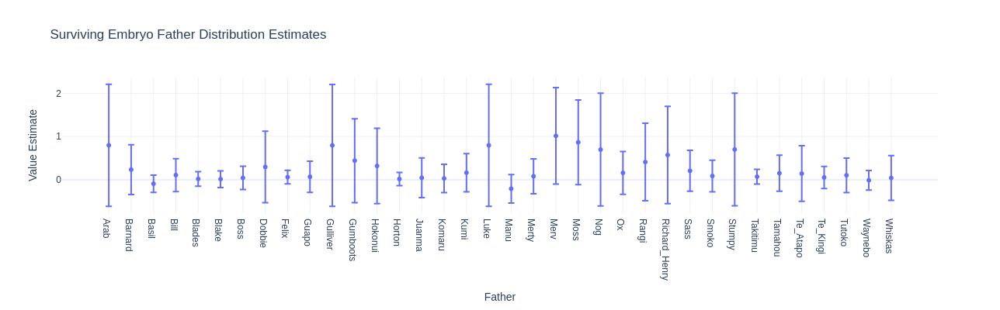

In [72]:
names = list(np.unique(x[['Father', 'Father_code']]['Father'].tolist()))
fig = px.scatter(x=names, y=father_.mean(), error_y=father_.stddev(),
          template="plotly_white",
          height=400, width=1200,
          title="Surviving Embryo Father Distribution Estimates",
          labels = {"x": "Father", "y": "Value Estimate"})

fig.write_image("figures/surviving_embryos_father_distribution.png")
fig

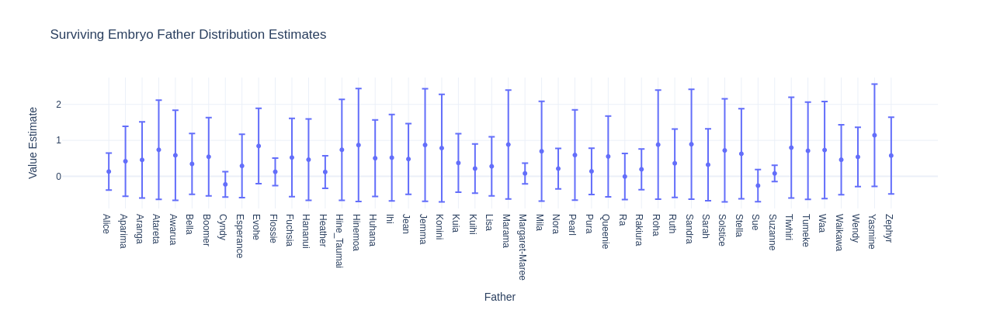

In [73]:
names = list(np.unique(x[['bird', 'bird_code']]['bird'].tolist()))
fig = px.scatter(x=names, y=mother_.mean(), error_y=mother_.stddev(),
          template="plotly_white",
          height=400, width=1200,
          title="Surviving Embryo Father Distribution Estimates",
          labels = {"x": "Father", "y": "Value Estimate"})

fig.write_image("figures/surviving_embryos_mother_distribution.png")
fig

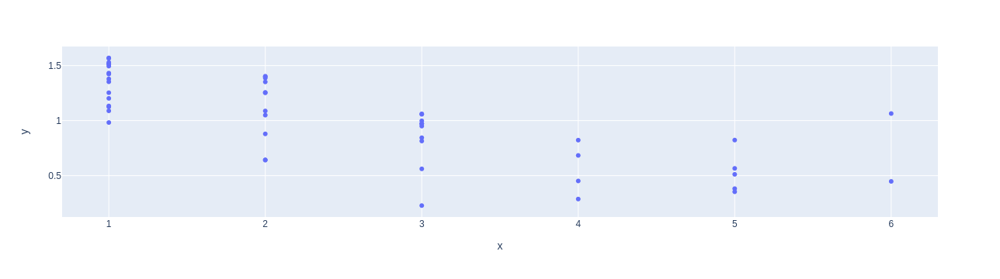

In [74]:
# How is # of observations related to the std. dev.
# It is as expected, although for 6 is goes up a bit
counts = x.sort_values(by='bird_code').groupby('bird').count()['Island'].tolist()
px.scatter(x=counts, y=mother_.stddev())

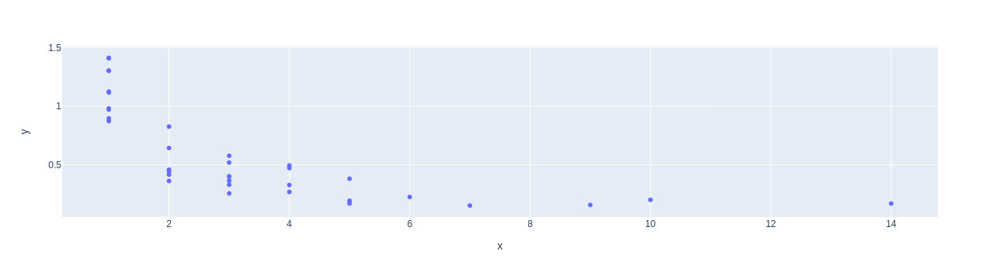

In [75]:
# How is # of observations related to the std. dev.
# It is as expected, although for 6 is goes up a bit
counts = x.sort_values(by='Father_code').groupby('Father').count()['Island'].tolist()
px.scatter(x=counts, y=father_.stddev())

In [76]:
phenos = dict()

for i, row in fertility.iterrows():
    phenos[row["Father"]] = father_.mean()[row["Father_code"]].numpy()
    phenos[row["bird"]] = mother_.mean()[row["bird_code"]].numpy()

In [77]:
phenos

{'Arab': 0.7962468,
 'Suzanne': 0.08151879,
 'Barnard': 0.23378362,
 'Kuihi': 0.2167898,
 'Flossie': 0.12708113,
 'Rakiura': 0.19614647,
 'Basil': -0.09309878,
 'Ruth': 0.36334673,
 'Sue': -0.2577515,
 'Lisa': 0.27849084,
 'Ra': -0.0055056633,
 'Aparima': 0.4201817,
 'Yasmine': 1.1431056,
 'Bill': 0.10735991,
 'Wendy': 0.5407151,
 'Cyndy': -0.22339381,
 'Blades': 0.018266276,
 'Aranga': 0.45792314,
 'Bella': 0.34587952,
 'Heather': 0.121575974,
 'Huhana': 0.504488,
 'Nora': 0.21510491,
 'Blake': 0.013458296,
 'Konini': 0.7858345,
 'Kuia': 0.37263545,
 'Mila': 0.6969697,
 'Stella': 0.6278173,
 'Waa': 0.7313595,
 'Boss': 0.042070433,
 'Tumeke': 0.7107826,
 'Alice': 0.1330444,
 'Pearl': 0.59259814,
 'Dobbie': 0.29536498,
 'Felix': 0.059979644,
 'Zephyr': 0.57787377,
 'Sandra': 0.8926503,
 'Guapo': 0.06713944,
 'Ihi': 0.5195338,
 'Gulliver': 0.79424393,
 'Gumboots': 0.44162792,
 'Hokonui': 0.31941894,
 'Horton': 0.01722832,
 'Tiwhiri': 0.7978124,
 'Hinemoa': 0.8702376,
 'Jemma': 0.87228686

In [78]:
phenos = pd.DataFrame.from_dict(phenos, columns=["SurvivingEmbryos"], orient="index")

In [79]:
phenos.to_csv("surviving_embryos_new.tsv", sep="\t")

In [80]:
phenos = phenos.reset_index()

In [81]:
# hibayes Format

fam = pd.read_csv("plink2.fam", sep="\t", header=None)

birds = list()
for i, row in fam.iterrows():
    birds.append(row[1])
df = phenos
with open("surviving_embryos_new_bayes_format.txt", "w") as writer:
    writer.write("vals\n")
    for i in birds:
        idx = df["index"] == i
        if np.sum(idx) == 0:
            writer.write("-9\n")
        else:
            writer.write(str(float(df[idx]["SurvivingEmbryos"])))
            writer.write("\n")

ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.ops.tensor_array_ops.TensorArray'>):
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
  File "/home/josephguhlin/miniconda3/envs/kakapophenos2022/lib/python3.8/site-packages/tensorflow_probability/python/math/minimize.py", line 114, in training_loop_body
    return [x for x in potential_new_loop_vars if x is not None]  File "/home/josephguhlin/miniconda3/envs/kakapophenos2022/lib/python3.8/site-packages/tensorflow/python/util/nest.py", line 913, in map_structure
    return pack_sequence_as(  File "/home/josephguhlin/miniconda3/envs/kakapophenos2022/lib/python3.8/site-packages/tensorflow/python/util/nest.py", line 914, in <listcomp>
    structure[0], [func(*x) for x in entries],  File "/home/josephguhlin/miniconda3/envs/kakapophenos2022/lib/python3.8/site-packages/tensorflow_probability/python/math/minimize.py", line 111, in <lambda>
    

In [88]:
# e2 = pd.read_csv("embryo_survival2.tsv", sep="\t", skiprows=0)
# e1 = pd.read_csv("embryo_survival.tsv", sep="\t", skiprows=2)
# e3 = phenos

In [89]:
phenos

,SurvivingEmbryos
Arab,0.783944
Suzanne,0.073291
Barnard,0.239736
Kuihi,0.198152
Flossie,0.111189
...,...
Queenie,0.534978
Waynebo,-0.032058
Solstice,0.706988
Whiskas,0.042252


In [90]:
# np.corrcoef(e1['SurvivingEmbryos'], e2['SurvivingEmbryos'])

In [ ]:
# np.corrcoef(e1['SurvivingEmbryos'], e3['SurvivingEmbryos'])

In [ ]:
# np.corrcoef(e2['SurvivingEmbryos'], e3['SurvivingEmbryos'])

In [ ]:
bs = pd.read_csv("surviving_embryos.tsv", sep="\t")
bs.insert(0, "#FID", "0")
bs.to_csv(
    "/home/josephguhlin/software/gcta_1.93.2beta/surviving_pheno_new",
    sep="\t",
    index=False,
    header=None,
)